# 0. Install StarDist as described [here]( https://github.com/stardist/stardist#installation) (and some dependencies)

In [1]:
import stardist
!pip install jupytext
!pip install git+https://github.com/stardist/augmend.git
import augmend
from augmend import (
    Augmend,
    FlipRot90,
    AdditiveNoise,
    Elastic,
    Rotate,
    IntensityScaleShift,
    Scale,
    Identity,
)
!pip install gputools pandas seaborn

  Cloning https://github.com/stardist/augmend.git to /private/var/folders/g1/m77h0b_d0fs7ymvpdv3l6n4h0000gr/T/pip-req-build-73fn1tyd
  Running command git clone --filter=blob:none --quiet https://github.com/stardist/augmend.git /private/var/folders/g1/m77h0b_d0fs7ymvpdv3l6n4h0000gr/T/pip-req-build-73fn1tyd
  Resolved https://github.com/stardist/augmend.git to commit c1849730bd363dbb6e46c86a3091254a14c5968b
  Preparing metadata (setup.py) ... done


# 1. Load packages

In [2]:
from __future__ import print_function, unicode_literals, absolute_import, division
import os
import sys
from pathlib import Path
import numpy as np
import matplotlib
matplotlib.rcParams["image.interpolation"] = "none"
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
matplotlib.rcParams['figure.figsize'] = (12, 5)
import pandas as pd
import tensorflow as tf
from glob import glob
import seaborn as sns 
from tqdm.notebook import tqdm
from tifffile import imread
from csbdeep.utils import normalize
from csbdeep.utils import Path

from stardist import fill_label_holes, random_label_cmap, calculate_extents, gputools_available
from stardist.matching import matching, matching_dataset
from stardist.models import Config2D, StarDist2D, StarDistData2D
from stardist.plot import render_label

from skimage.transform import resize
np.random.seed(42)
lbl_cmap = random_label_cmap()

### Download data (images and masks, uncomment and only do this once!)

In [3]:
# !wget https://drive.switch.ch/index.php/s/F8wpskqkkyVfnm0/download -O data.zip 
# !unzip data.zip

# 2. Load and prepare annotated image

In [4]:
base_path = Path("yeastnet")

Utility functions

In [5]:
def plot_img_label(img, lbl, img_title="image", lbl_title="label", **kwargs):
    fig, (ai,al) = plt.subplots(1,2, figsize=(12,5), gridspec_kw=dict(width_ratios=(1,1)))
    im = ai.imshow(img, cmap='gray', clim=(0,1))
    ai.set_title(img_title)    
    al.imshow(render_label(lbl, img=.3*img, normalize_img=False, cmap=lbl_cmap))
    al.set_title(lbl_title)
    plt.tight_layout()
    
def preprocess(X, Y, axis_norm=(0,1)):
    # normalize channels independently

    if n_channel > 1:
        print("Normalizing image channels %s." % ('jointly' if axis_norm is None or 2 in axis_norm else 'independently'))
        sys.stdout.flush()
    X = [normalize(x,1,99.8,axis=axis_norm) for x in tqdm(X, leave=False, desc="Normalize images")]
    Y = [fill_label_holes(y) for y in tqdm(Y, leave=False, desc="Fill holes in labels")]
    return X, Y

In [6]:
img = imread(base_path / 'train/images/yeastnet_img_010.tif')
lbl = imread(base_path / 'train/masks/yeastnet_010_mask.tif')
n_channel = 1

Normalize images using intensity percentiles and fill small label holes.

Normalize images:   0%|          | 0/1 [00:00<?, ?it/s]

Fill holes in labels:   0%|          | 0/1 [00:00<?, ?it/s]

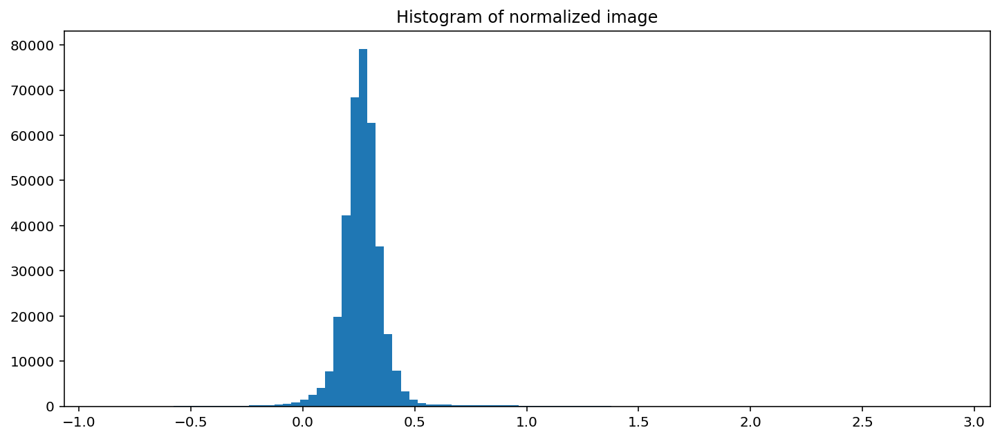

In [7]:
img, lbl = preprocess([img], [lbl])
img, lbl = img[0], lbl[0]
plt.hist(img.flatten(), bins=100)
plt.title("Histogram of normalized image")
plt.show();

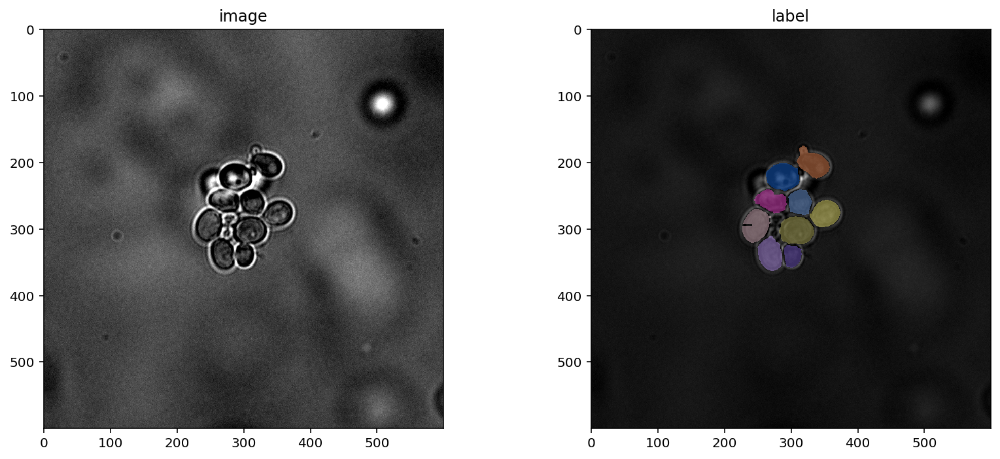

In [8]:
plot_img_label(img, lbl)

# 3. Load entire dataset
We assume that data has already been split into disjoint training, validation and test sets.

In [9]:
# TODO more realistic here: Annotate a second image by hand, use that as validation?
num_imgs = 0
data = {}
for split in ["train", "val", "test"]:
    X = sorted((base_path / split / "images").glob("*.tif"))
    X = [imread(x) for x in X]
    Y = sorted((base_path / split / "masks").glob("*.tif"))
    Y = [imread(y) for y in Y]
    data[split] = (X.copy(), Y.copy())
    num_imgs += len(X)
X_trn, Y_trn = data["train"]
X_val, Y_val = data["val"]
X_test, Y_test = data["test"]
print('number of images: %3d' % num_imgs)
print('- training:       %3d' % len(X_trn))
print('- validation:     %3d' % len(X_val))
print('- test:     %3d' % len(X_test))
print(f"Number of channels: {n_channel}")

number of images: 150
- training:       127
- validation:       8
- test:      15
Number of channels: 1


In [10]:
X_trn, Y_trn = preprocess(X_trn, Y_trn)
X_val, Y_val = preprocess(X_val, Y_val)
X_test, Y_test = preprocess(X_test, Y_test)

Normalize images:   0%|          | 0/127 [00:00<?, ?it/s]

Fill holes in labels:   0%|          | 0/127 [00:00<?, ?it/s]

Normalize images:   0%|          | 0/8 [00:00<?, ?it/s]

Fill holes in labels:   0%|          | 0/8 [00:00<?, ?it/s]

Normalize images:   0%|          | 0/15 [00:00<?, ?it/s]

Fill holes in labels:   0%|          | 0/15 [00:00<?, ?it/s]

# 4. Training with a single annotated image

We're going to annotate two images: one will be used to train the model, while the other will be used for validation purposes.

## Training setup

In [11]:
n_rays = 32

# Use OpenCL-based computations for data generator during training (requires 'gputools')
use_gpu = True and gputools_available()

# Predict on subsampled grid for increased efficiency and larger field of view
grid = (2,2)

conf = Config2D (
    n_rays = n_rays,
    grid = grid,
    use_gpu = use_gpu,
    n_channel_in = n_channel,
    train_learning_rate = 0.0005,
    train_patch_size = (384,384),
    train_epochs=30, 
)

# Print config to see default values
vars(conf)

If you want to compute separable approximations, please install it with
pip install scikit-tensor-py3


{'n_dim': 2,
 'axes': 'YXC',
 'n_channel_in': 1,
 'n_channel_out': 33,
 'train_checkpoint': 'weights_best.h5',
 'train_checkpoint_last': 'weights_last.h5',
 'train_checkpoint_epoch': 'weights_now.h5',
 'n_rays': 32,
 'grid': (2, 2),
 'backbone': 'unet',
 'n_classes': None,
 'unet_n_depth': 3,
 'unet_kernel_size': (3, 3),
 'unet_n_filter_base': 32,
 'unet_n_conv_per_depth': 2,
 'unet_pool': (2, 2),
 'unet_activation': 'relu',
 'unet_last_activation': 'relu',
 'unet_batch_norm': False,
 'unet_dropout': 0.0,
 'unet_prefix': '',
 'net_conv_after_unet': 128,
 'net_input_shape': (None, None, 1),
 'net_mask_shape': (None, None, 1),
 'train_shape_completion': False,
 'train_completion_crop': 32,
 'train_patch_size': (384, 384),
 'train_background_reg': 0.0001,
 'train_foreground_only': 0.9,
 'train_sample_cache': True,
 'train_dist_loss': 'mae',
 'train_loss_weights': (1, 0.2),
 'train_class_weights': (1, 1),
 'train_epochs': 30,
 'train_steps_per_epoch': 100,
 'train_learning_rate': 0.0005,
 

In [12]:
if use_gpu:
    from csbdeep.utils.tf import limit_gpu_memory
    # adjust as necessary: limit GPU memory to be used by TensorFlow to leave some to OpenCL-based computations
    limit_gpu_memory(.9, total_memory=16000)

In [13]:
model = StarDist2D(conf, name='single_image', basedir='models')

Metal device set to: Apple M1 Max
Using default values: prob_thresh=0.5, nms_thresh=0.4.


2022-06-24 17:57:24.180934: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-06-24 17:57:24.181067: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Check if the neural network has a large enough field of view to see up to the boundary of most objects.

In [14]:
median_size = calculate_extents(list([lbl]), np.median)
fov = np.array(model._axes_tile_overlap('YX'))
print(f"median object size:      {median_size}")
print(f"network field of view :  {fov}")
if any(median_size > fov):
    print("WARNING: median object size larger than field of view of the neural network.")

1/1 [==============================] - 0s 168ms/step


2022-06-24 17:57:24.403577: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-06-24 17:57:24.475725: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 12ms/step
median object size:      [42. 46.]
network field of view :  [93 94]


In [15]:
df = pd.DataFrame()
def add_history(df0, hist, name):
    #convert history dict to dataframe and add/concatenate it to an existing dataframe 
    keys = tuple(c.split('val_')[1] for c in hist.keys() if c.startswith('val_'))
    res_train = dict(tuple((k,hist[k]) for k in keys) + (('phase', 'train'),))
    res_val = dict(tuple((k,hist[f'val_{k}']) for k in keys) + (('phase', 'val'),))
    for res in (res_train, res_val):
        res['name'] = name
        res['step'] = np.arange(len(hist['loss']))
    df = pd.concat((pd.DataFrame(res_train), pd.DataFrame(res_val)))
    df = pd.concat((df0, df)).reset_index(drop=True)
    return df    

In [16]:
# %%capture
X_val_single, Y_val_single = [X_val[5]], [Y_val[5]]
log = model.train([img], [lbl], 
                  validation_data=(X_val_single, Y_val_single), 
                  steps_per_epoch=20, 
                  seed=42)
df = add_history(df, log.history, 'single image')
model.optimize_thresholds(X_val_single, Y_val_single)

Epoch 1/30
Cause: Unable to locate the source code of <function _gcd_import at 0x1026c83a0>. Note that functions defined in certain environments, like the interactive Python shell, do not expose their source code. If that is the case, you should define them in a .py source file. If you are certain the code is graph-compatible, wrap the call using @tf.autograph.experimental.do_not_convert. Original error: could not get source code
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Cause: Unable to locate the source code of <function _gcd_import at 0x1026c83a0>. Note that functions defined in certain environments, like the interactive Python shell, do not expose their source code. If that is the case, you should define them in a .py source file. If you are certain the code is graph-compatible, wrap the call using @tf.autograph.experimental.do_not_convert. Original error: could not get source code
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Cause: Unable to locate the source code of <function _gcd_import at 0x1026c83a0>. Note that functions defined in certain environments, like the interactive Python shell, do not expose their source code. If that is the case, you should define them in a .py source file. If you are certain the code is graph-compatible, wrap the call using @tf.autograph.experimental.do_not_convert. Original error: could not get source code
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


2022-06-24 17:57:25.921201: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


 6/20 [========>.....................] - ETA: 2s - loss: 6.9832 - prob_loss: 1.0227 - dist_loss: 29.8026 - prob_kld: 0.9514 - dist_relevant_mae: 29.8026 - dist_relevant_mse: 706.1979 - dist_dist_iou_metric: 1.1331e-05WARNING:tensorflow:Callback method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0897s vs `on_train_batch_end` time: 0.1148s). Check your callbacks.


20/20 [==============================] - ETA: 0s - loss: 6.1201 - prob_loss: 0.8550 - dist_loss: 26.3257 - prob_kld: 0.6906 - dist_relevant_mae: 26.3253 - dist_relevant_mse: 590.4106 - dist_dist_iou_metric: 0.0787

2022-06-24 17:57:30.665784: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


20/20 [==============================] - 6s 249ms/step - loss: 6.1201 - prob_loss: 0.8550 - dist_loss: 26.3257 - prob_kld: 0.6906 - dist_relevant_mae: 26.3253 - dist_relevant_mse: 590.4106 - dist_dist_iou_metric: 0.0787 - val_loss: 5.4034 - val_prob_loss: 1.0582 - val_dist_loss: 21.7261 - val_prob_kld: 0.8885 - val_dist_relevant_mae: 21.7255 - val_dist_relevant_mse: 432.9552 - val_dist_dist_iou_metric: 0.1241 - lr: 5.0000e-04
Epoch 2/30


2022-06-24 17:57:31.119609: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


20/20 [==============================] - 4s 220ms/step - loss: 3.7856 - prob_loss: 0.4422 - dist_loss: 16.7171 - prob_kld: 0.3621 - dist_relevant_mae: 16.7157 - dist_relevant_mse: 277.9239 - dist_dist_iou_metric: 0.4651 - val_loss: 3.3786 - val_prob_loss: 0.7266 - val_dist_loss: 13.2599 - val_prob_kld: 0.5569 - val_dist_relevant_mae: 13.2580 - val_dist_relevant_mse: 174.6551 - val_dist_dist_iou_metric: 0.6354 - lr: 5.0000e-04
Epoch 3/30
20/20 [==============================] - 4s 219ms/step - loss: 2.8818 - prob_loss: 0.2778 - dist_loss: 13.0203 - prob_kld: 0.2072 - dist_relevant_mae: 13.0182 - dist_relevant_mse: 164.6139 - dist_dist_iou_metric: 0.6751 - val_loss: 3.0020 - val_prob_loss: 0.5499 - val_dist_loss: 12.2607 - val_prob_kld: 0.3802 - val_dist_relevant_mae: 12.2584 - val_dist_relevant_mse: 146.3678 - val_dist_dist_iou_metric: 0.7061 - lr: 5.0000e-04
Epoch 4/30
20/20 [==============================] - 4s 219ms/step - loss: 2.7538 - prob_loss: 0.2261 - dist_loss: 12.6387 - prob_

Epoch 15/30
20/20 [==============================] - 4s 218ms/step - loss: 0.9842 - prob_loss: 0.0802 - dist_loss: 4.5201 - prob_kld: 0.0096 - dist_relevant_mae: 4.5192 - dist_relevant_mse: 28.5549 - dist_dist_iou_metric: 1.1882 - val_loss: 2.4668 - val_prob_loss: 0.4578 - val_dist_loss: 10.0453 - val_prob_kld: 0.2655 - val_dist_relevant_mae: 10.0443 - val_dist_relevant_mse: 116.8791 - val_dist_dist_iou_metric: 0.7997 - lr: 5.0000e-04
Epoch 16/30
20/20 [==============================] - 4s 221ms/step - loss: 0.9186 - prob_loss: 0.0794 - dist_loss: 4.1960 - prob_kld: 0.0084 - dist_relevant_mae: 4.1952 - dist_relevant_mse: 25.2877 - dist_dist_iou_metric: 1.2163 - val_loss: 2.5778 - val_prob_loss: 0.4644 - val_dist_loss: 10.5670 - val_prob_kld: 0.2875 - val_dist_relevant_mae: 10.5662 - val_dist_relevant_mse: 130.0646 - val_dist_dist_iou_metric: 0.7643 - lr: 5.0000e-04
Epoch 17/30
20/20 [==============================] - 4s 219ms/step - loss: 0.8804 - prob_loss: 0.0788 - dist_loss: 4.0081 

Epoch 28/30
20/20 [==============================] - 4s 216ms/step - loss: 0.5479 - prob_loss: 0.0755 - dist_loss: 2.3621 - prob_kld: 0.0051 - dist_relevant_mae: 2.3614 - dist_relevant_mse: 9.5387 - dist_dist_iou_metric: 1.3771 - val_loss: 2.8588 - val_prob_loss: 0.5068 - val_dist_loss: 11.7603 - val_prob_kld: 0.3196 - val_dist_relevant_mae: 11.7595 - val_dist_relevant_mse: 155.7804 - val_dist_dist_iou_metric: 0.7282 - lr: 5.0000e-04
Epoch 29/30
20/20 [==============================] - 4s 216ms/step - loss: 0.5384 - prob_loss: 0.0760 - dist_loss: 2.3120 - prob_kld: 0.0049 - dist_relevant_mae: 2.3114 - dist_relevant_mse: 9.1251 - dist_dist_iou_metric: 1.3851 - val_loss: 2.5601 - val_prob_loss: 0.3843 - val_dist_loss: 10.8788 - val_prob_kld: 0.2079 - val_dist_relevant_mae: 10.8780 - val_dist_relevant_mse: 133.9393 - val_dist_dist_iou_metric: 0.7648 - lr: 5.0000e-04
Epoch 30/30
20/20 [==============================] - 4s 217ms/step - loss: 0.5097 - prob_loss: 0.0755 - dist_loss: 2.1712 - 

2022-06-24 17:59:38.212511: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
NMS threshold = 0.5:  75%|███████████████████████████████████████████████████████████████████████████████████▎                           | 15/20 [00:00<00:00, 28.49it/s, 0.762 -> 0.672]


Using optimized values: prob_thresh=0.761996, nms_thresh=0.3.
Saving to 'thresholds.json'.


{'prob': 0.761995750331747, 'nms': 0.3}

<AxesSubplot:xlabel='step', ylabel='loss'>

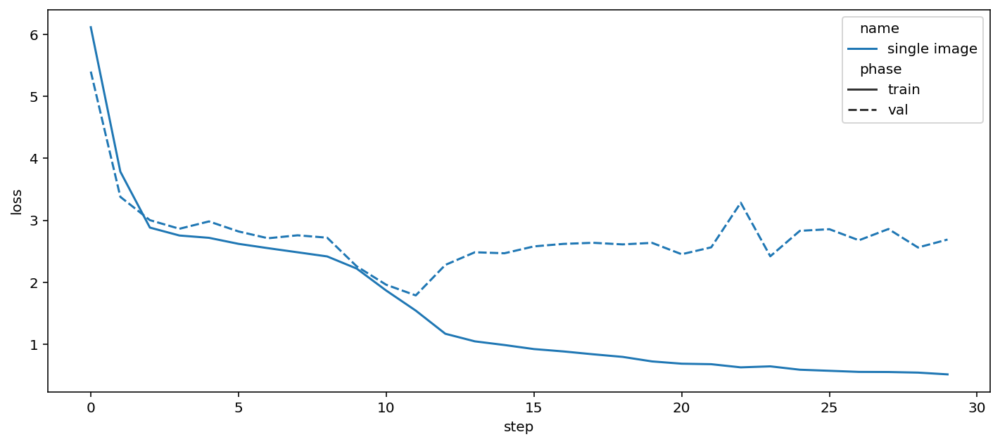

In [17]:
sns.lineplot(data=df, x='step', y='loss', hue = 'name', style='phase')

1/1 [==============================] - 0s 66ms/step


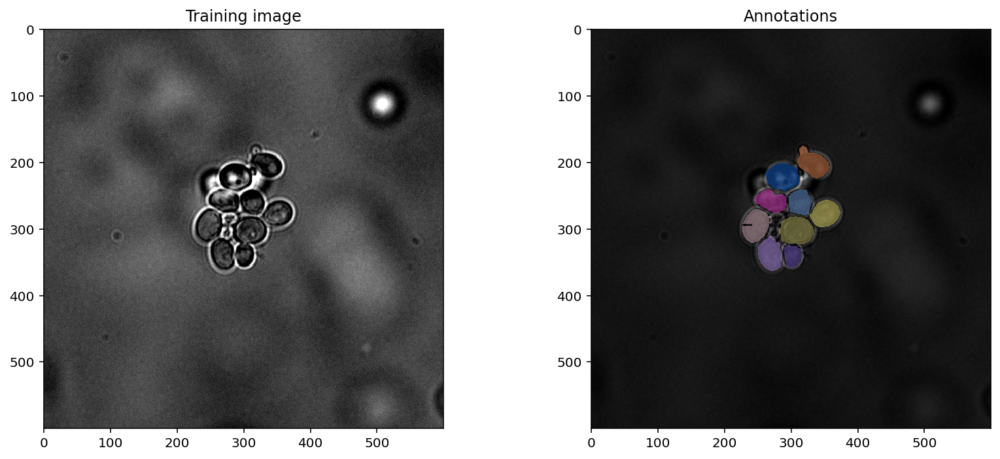

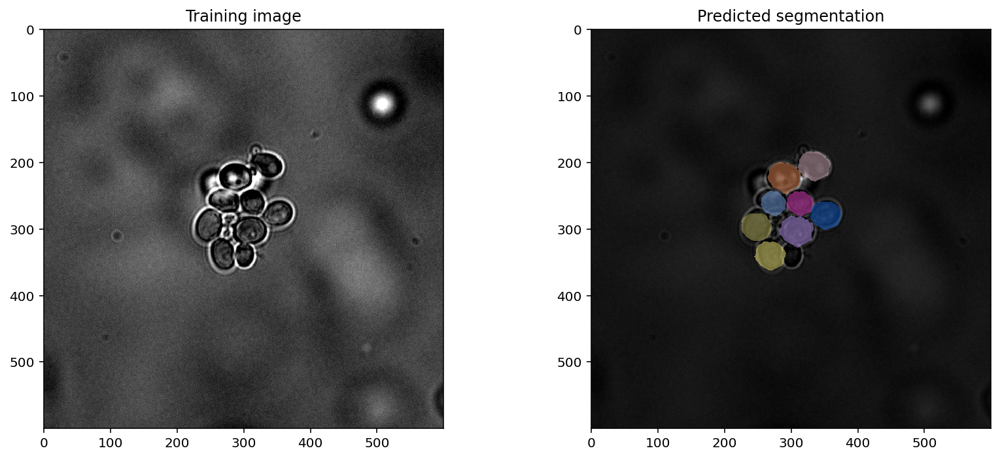

In [18]:
pred = model.predict_instances(img, n_tiles=model._guess_n_tiles(img), show_tile_progress=False)[0]
plot_img_label(img, lbl, img_title="Training image", lbl_title="Annotations")
plot_img_label(img, pred, img_title="Training image", lbl_title="Predicted segmentation")

### Prediction on unseen test image (single image model)

In [19]:
idx_test = 3
Y_pred_single, _  = model.predict_instances(X_test[idx_test])

1/1 [==============================] - 0s 19ms/step


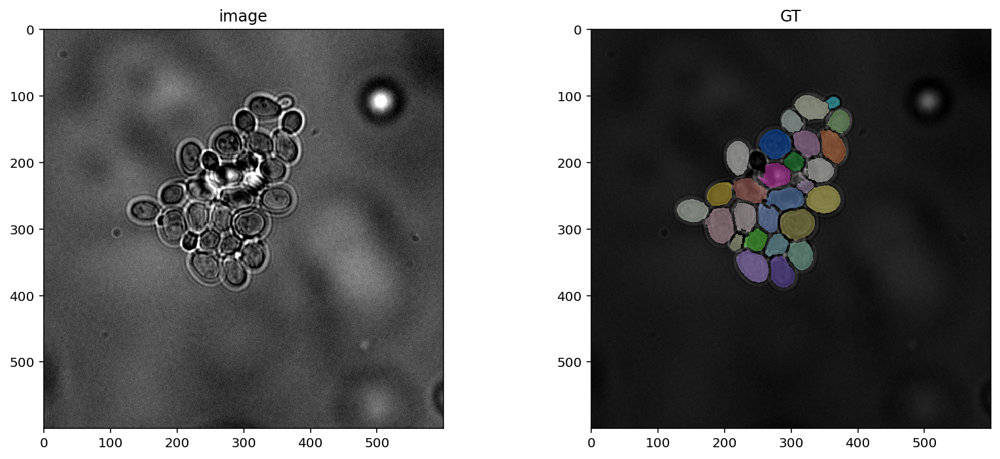

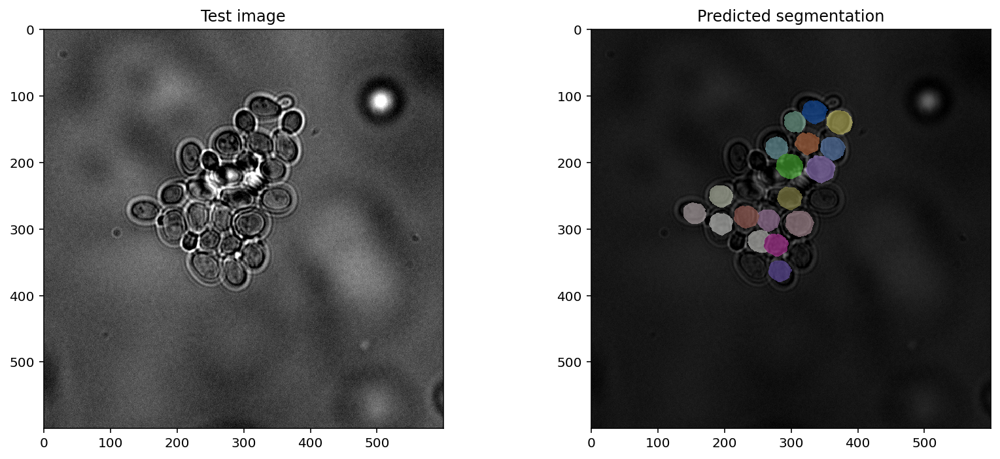

In [20]:
plot_img_label(X_test[idx_test],Y_test[idx_test], lbl_title="GT")
plot_img_label(X_test[idx_test], Y_pred_single, img_title=f"Test image", lbl_title="Predicted segmentation")

# 5. More training data, part 1: Augmentations

Original image

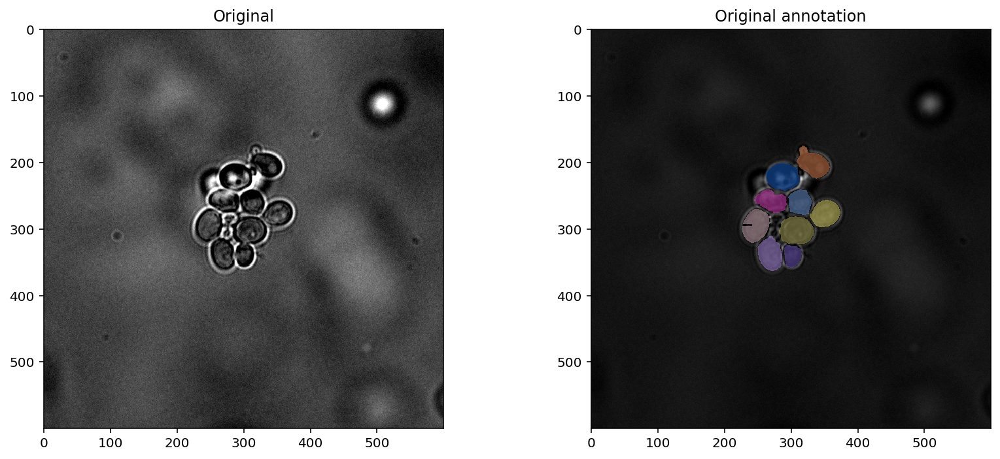

In [21]:
plot_img_label(img, lbl, img_title="Original", lbl_title="Original annotation")

Transformed image.

Comment/Uncomment individual lines to apply different random transformations. Documentation at https://github.com/stardist/augmend.

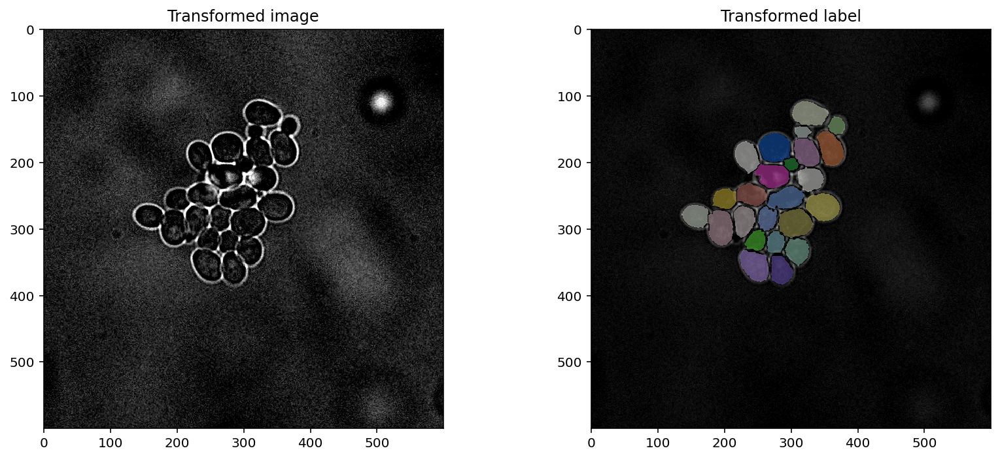

In [22]:
transform = Augmend()
transform.add([IntensityScaleShift(scale=(0.75, 1.33), shift=(-0.33, 0.33)), Identity()])
transform.add([AdditiveNoise(), Identity()])
transform.add([Elastic(amount=3, grid=5, order=1, use_gpu=False), Elastic(amount=3, grid=5, order=0, use_gpu=False)])
# transform.add([Rotate(order=1, mode="constant"), Rotate(order=0, mode="constant")])
# transform.add([Elastic(amount=32, order=1), Elastic(amount=32, order=0)])
# transform.add([Scale(order=1), Scale(order=0)])


img_aug, lbl_aug = transform([X_trn[15], Y_trn[15]])
plot_img_label(img_aug, lbl_aug, img_title="Transformed image", lbl_title="Transformed label")

In [23]:
def build_augmenter(use_gpu):
    axis= (0, 1)
    aug = Augmend()
    aug.add([Elastic(amount=5, grid=11, use_gpu=False, order=1, axis=axis), Elastic(amount=5, grid=11, use_gpu=False, order=0, axis=axis)])
    aug.add([Rotate(order=1, mode="constant"), Rotate(order=0, mode="constant")])
    aug.add([IntensityScaleShift(scale=(0.75, 1.33), shift=(-0.1, 0.1)), Identity()])
    aug.add([Scale(order=1, amount=(.8,1.25), mode="constant"), Scale(order=0, amount=(.8,1.25), mode="constant")])
    aug.add([AdditiveNoise(sigma=0.1), Identity()])

    return aug

augmenter = build_augmenter(use_gpu=False)
augmenter_fun = lambda x, y: augmenter((x, y))

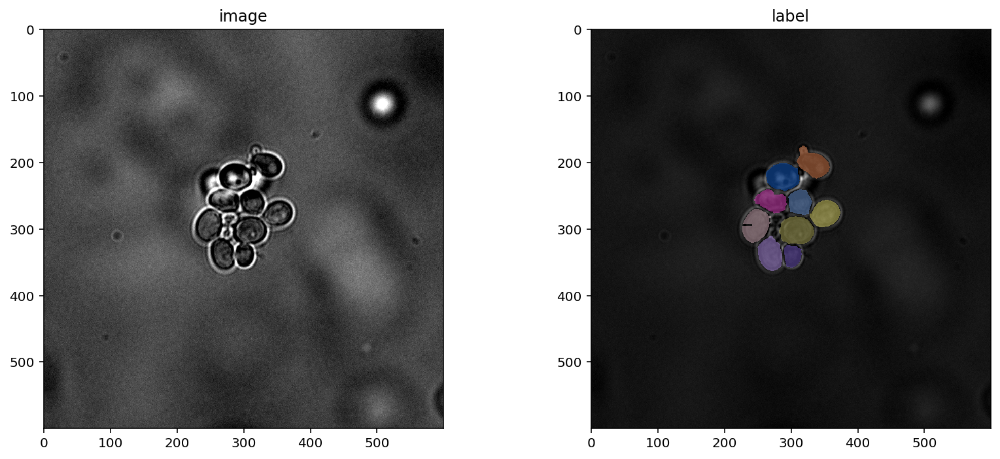

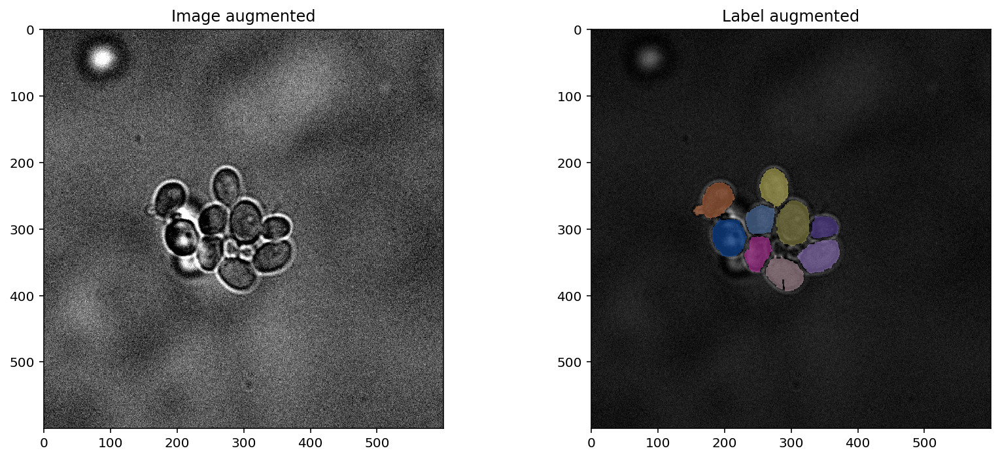

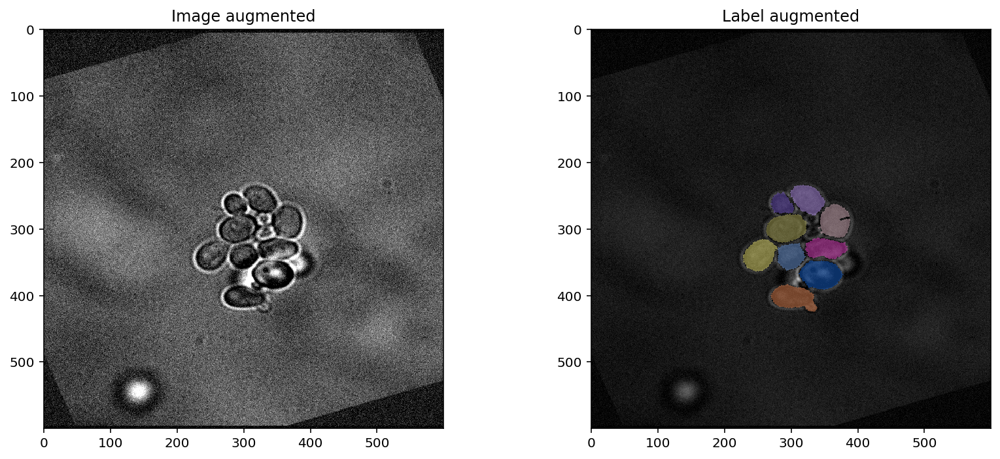

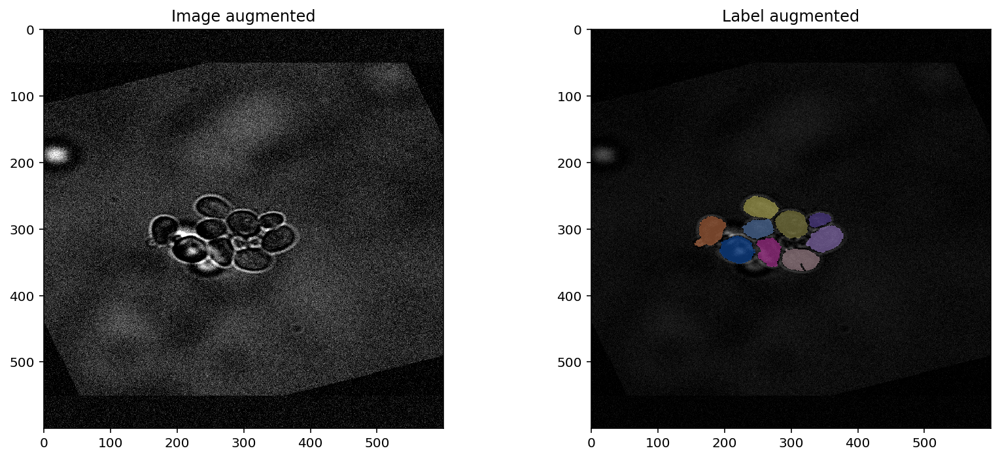

In [24]:
# plot some augmented examples
plot_img_label(img, lbl)
for _ in range(3):
    img_aug, lbl_aug = augmenter_fun(img,lbl)
    plot_img_label(img_aug, lbl_aug, img_title="Image augmented", lbl_title="Label augmented")

In [25]:
model_aug = StarDist2D(conf, name='single_image_augmented_test', basedir='models')

Using default values: prob_thresh=0.5, nms_thresh=0.4.


In [26]:
# %%capture
log_aug = model_aug.train(
    [img],
    [lbl],
    validation_data=(X_val_single, Y_val_single),
    augmenter=augmenter_fun,
    steps_per_epoch=20,
    seed=42
)
df = add_history(df, log_aug.history, 'single image w augmentation')
model_aug.optimize_thresholds(X_val_single, Y_val_single)

Epoch 1/30


2022-06-24 17:59:45.119212: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


 6/20 [========>.....................] - ETA: 3s - loss: 7.0022 - prob_loss: 0.9669 - dist_loss: 30.1767 - prob_kld: 0.8951 - dist_relevant_mae: 30.1767 - dist_relevant_mse: 739.9689 - dist_dist_iou_metric: 5.8001e-05WARNING:tensorflow:Callback method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0952s vs `on_train_batch_end` time: 0.1143s). Check your callbacks.


20/20 [==============================] - ETA: 0s - loss: 6.2020 - prob_loss: 0.8119 - dist_loss: 26.9502 - prob_kld: 0.6340 - dist_relevant_mae: 26.9498 - dist_relevant_mse: 632.4559 - dist_dist_iou_metric: 0.0809

2022-06-24 17:59:50.032607: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


20/20 [==============================] - 6s 252ms/step - loss: 6.2020 - prob_loss: 0.8119 - dist_loss: 26.9502 - prob_kld: 0.6340 - dist_relevant_mae: 26.9498 - dist_relevant_mse: 632.4559 - dist_dist_iou_metric: 0.0809 - val_loss: 5.2514 - val_prob_loss: 1.0683 - val_dist_loss: 20.9157 - val_prob_kld: 0.8986 - val_dist_relevant_mae: 20.9151 - val_dist_relevant_mse: 410.6790 - val_dist_dist_iou_metric: 0.1640 - lr: 5.0000e-04
Epoch 2/30


2022-06-24 17:59:50.459203: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


20/20 [==============================] - 4s 223ms/step - loss: 3.9615 - prob_loss: 0.4079 - dist_loss: 17.7681 - prob_kld: 0.3336 - dist_relevant_mae: 17.7665 - dist_relevant_mse: 323.5271 - dist_dist_iou_metric: 0.4555 - val_loss: 3.5322 - val_prob_loss: 0.5110 - val_dist_loss: 15.1056 - val_prob_kld: 0.3414 - val_dist_relevant_mae: 15.1042 - val_dist_relevant_mse: 236.2508 - val_dist_dist_iou_metric: 0.4431 - lr: 5.0000e-04
Epoch 3/30
20/20 [==============================] - 4s 219ms/step - loss: 3.1670 - prob_loss: 0.2763 - dist_loss: 14.4537 - prob_kld: 0.2036 - dist_relevant_mae: 14.4516 - dist_relevant_mse: 210.7446 - dist_dist_iou_metric: 0.6142 - val_loss: 3.2083 - val_prob_loss: 0.5846 - val_dist_loss: 13.1183 - val_prob_kld: 0.4150 - val_dist_relevant_mae: 13.1167 - val_dist_relevant_mse: 176.0458 - val_dist_dist_iou_metric: 0.5653 - lr: 5.0000e-04
Epoch 4/30
20/20 [==============================] - 4s 219ms/step - loss: 3.0315 - prob_loss: 0.2789 - dist_loss: 13.7628 - prob_

Epoch 15/30
20/20 [==============================] - 4s 221ms/step - loss: 2.9076 - prob_loss: 0.2273 - dist_loss: 13.4015 - prob_kld: 0.1529 - dist_relevant_mae: 13.3987 - dist_relevant_mse: 178.0840 - dist_dist_iou_metric: 0.6744 - val_loss: 2.9902 - val_prob_loss: 0.4202 - val_dist_loss: 12.8498 - val_prob_kld: 0.2505 - val_dist_relevant_mae: 12.8479 - val_dist_relevant_mse: 173.9894 - val_dist_dist_iou_metric: 0.5498 - lr: 5.0000e-04
Epoch 16/30
20/20 [==============================] - 4s 221ms/step - loss: 2.7737 - prob_loss: 0.2036 - dist_loss: 12.8506 - prob_kld: 0.1335 - dist_relevant_mae: 12.8477 - dist_relevant_mse: 167.7513 - dist_dist_iou_metric: 0.6709 - val_loss: 2.8589 - val_prob_loss: 0.4313 - val_dist_loss: 12.1385 - val_prob_kld: 0.2616 - val_dist_relevant_mae: 12.1364 - val_dist_relevant_mse: 160.5505 - val_dist_dist_iou_metric: 0.5986 - lr: 5.0000e-04
Epoch 17/30
20/20 [==============================] - 4s 219ms/step - loss: 2.8768 - prob_loss: 0.2458 - dist_loss: 1

Epoch 28/30
20/20 [==============================] - 4s 220ms/step - loss: 1.1843 - prob_loss: 0.0849 - dist_loss: 5.4974 - prob_kld: 0.0136 - dist_relevant_mae: 5.4956 - dist_relevant_mse: 40.6065 - dist_dist_iou_metric: 1.1254 - val_loss: 1.2485 - val_prob_loss: 0.1916 - val_dist_loss: 5.2844 - val_prob_kld: 0.0219 - val_dist_relevant_mae: 5.2832 - val_dist_relevant_mse: 35.1505 - val_dist_dist_iou_metric: 1.0702 - lr: 5.0000e-04
Epoch 29/30
20/20 [==============================] - 4s 221ms/step - loss: 1.2181 - prob_loss: 0.0878 - dist_loss: 5.6517 - prob_kld: 0.0144 - dist_relevant_mae: 5.6498 - dist_relevant_mse: 43.2445 - dist_dist_iou_metric: 1.1185 - val_loss: 1.2269 - val_prob_loss: 0.1911 - val_dist_loss: 5.1789 - val_prob_kld: 0.0215 - val_dist_relevant_mae: 5.1775 - val_dist_relevant_mse: 33.8039 - val_dist_dist_iou_metric: 1.0737 - lr: 5.0000e-04
Epoch 30/30
20/20 [==============================] - 4s 220ms/step - loss: 1.1376 - prob_loss: 0.0844 - dist_loss: 5.2661 - prob

2022-06-24 18:01:58.312568: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
NMS threshold = 0.5:  75%|███████████████████████████████████████████████████████████████████████████████████▎                           | 15/20 [00:00<00:00, 34.13it/s, 0.461 -> 0.935]


Using optimized values: prob_thresh=0.460914, nms_thresh=0.3.
Saving to 'thresholds.json'.


{'prob': 0.4609139741669614, 'nms': 0.3}

<AxesSubplot:xlabel='step', ylabel='loss'>

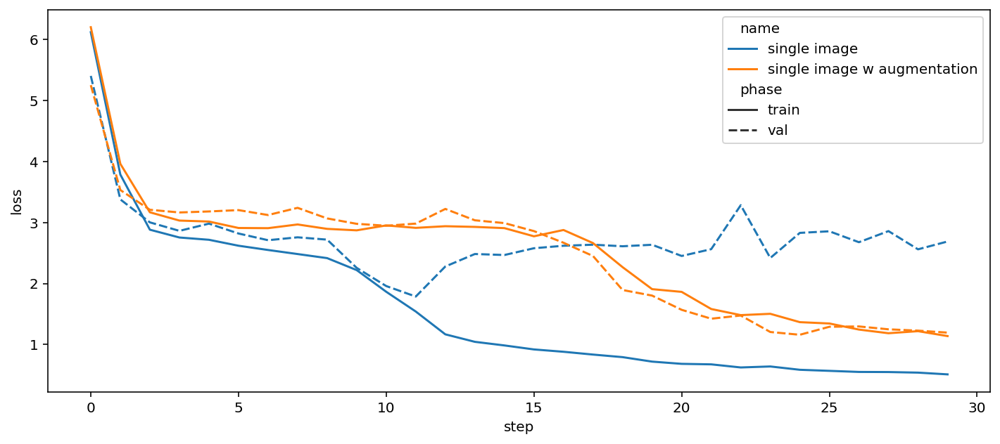

In [27]:
sns.lineplot(data=df, x='step', y='loss', hue = 'name', style='phase')

1/1 [==============================] - 0s 74ms/step


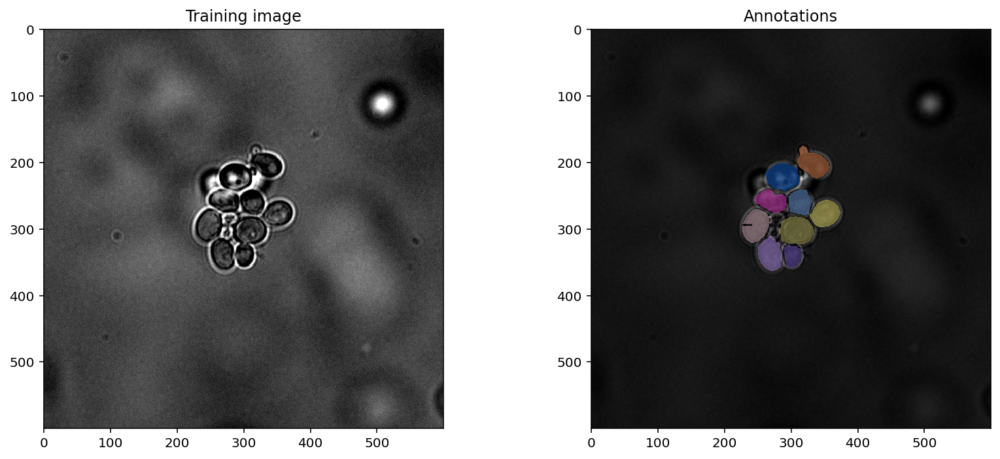

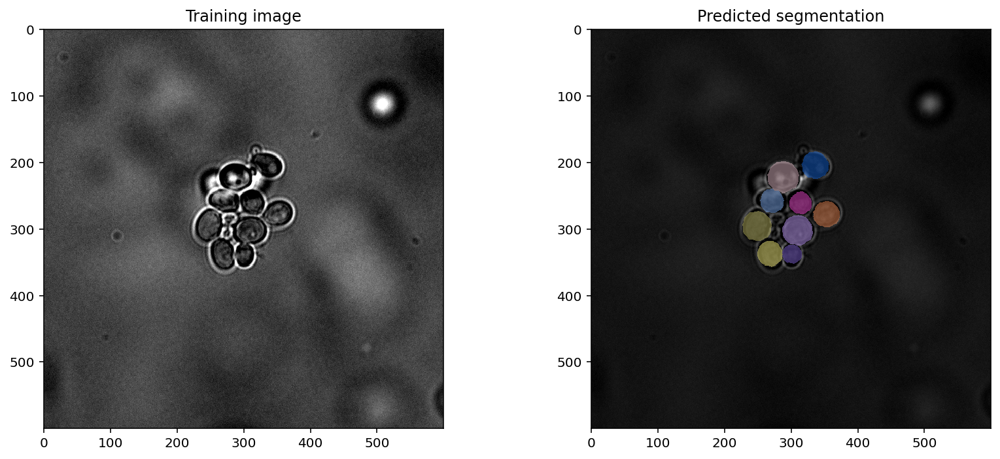

In [28]:
pred_aug = model_aug.predict_instances(img, n_tiles=model_aug._guess_n_tiles(img), show_tile_progress=False)[0]
plot_img_label(img, lbl, img_title="Training image", lbl_title="Annotations")
plot_img_label(img, pred_aug, img_title="Training image", lbl_title="Predicted segmentation")

### Prediction on unseen test image (single image model with augmentation)

1/1 [==============================] - 0s 22ms/step


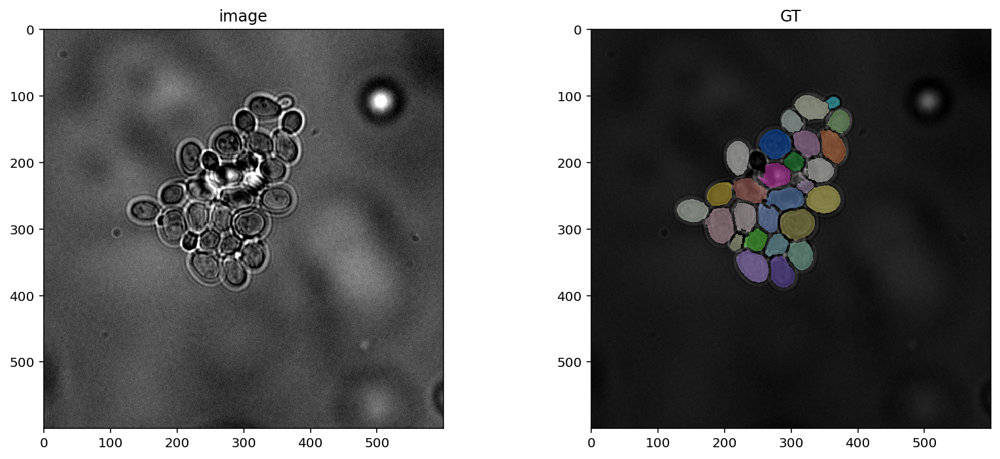

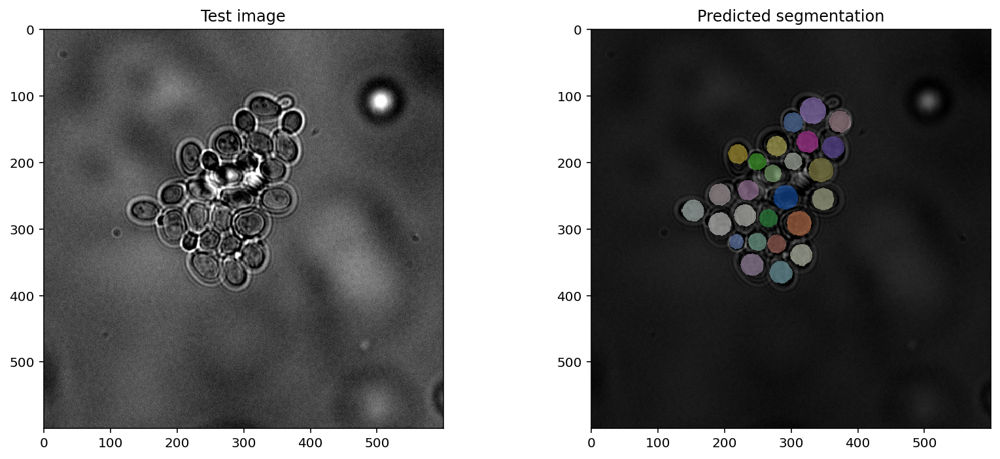

In [29]:
Y_pred_aug, _  = model_aug.predict_instances(X_test[idx_test])

plot_img_label(X_test[idx_test],Y_test[idx_test], lbl_title="GT")
plot_img_label(X_test[idx_test], Y_pred_aug, img_title=f"Test image", lbl_title="Predicted segmentation")

# 6. More training data, part 2: Annotate more by hand!

In [30]:
model_full = StarDist2D(conf, name='full_dataset', basedir='models')
history_regular = model_full.train(X_trn, Y_trn, 
                                   validation_data=(X_val,Y_val), 
                                   augmenter=augmenter_fun, 
                                   steps_per_epoch=50)

df = add_history(df, history_regular.history, 'full')
model_full.optimize_thresholds(X_val, Y_val)

Using default values: prob_thresh=0.5, nms_thresh=0.4.
Epoch 1/30


2022-06-24 18:02:02.689716: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


50/50 [==============================] - ETA: 0s - loss: 4.9173 - prob_loss: 0.7368 - dist_loss: 20.9025 - prob_kld: 0.5133 - dist_relevant_mae: 20.9015 - dist_relevant_mse: 423.3869 - dist_dist_iou_metric: 0.2687

2022-06-24 18:02:14.524800: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 34ms/step


2022-06-24 18:02:15.029486: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


50/50 [==============================] - 13s 243ms/step - loss: 4.9173 - prob_loss: 0.7368 - dist_loss: 20.9025 - prob_kld: 0.5133 - dist_relevant_mae: 20.9015 - dist_relevant_mse: 423.3869 - dist_dist_iou_metric: 0.2687 - val_loss: 3.7923 - val_prob_loss: 0.6610 - val_dist_loss: 15.6565 - val_prob_kld: 0.4042 - val_dist_relevant_mae: 15.6553 - val_dist_relevant_mse: 251.9168 - val_dist_dist_iou_metric: 0.3472 - lr: 5.0000e-04
Epoch 2/30
50/50 [==============================] - 11s 220ms/step - loss: 3.2038 - prob_loss: 0.5632 - dist_loss: 13.2032 - prob_kld: 0.3447 - dist_relevant_mae: 13.2011 - dist_relevant_mse: 176.6784 - dist_dist_iou_metric: 0.6174 - val_loss: 3.3601 - val_prob_loss: 0.6421 - val_dist_loss: 13.5899 - val_prob_kld: 0.3853 - val_dist_relevant_mae: 13.5884 - val_dist_relevant_mse: 193.0470 - val_dist_dist_iou_metric: 0.4770 - lr: 5.0000e-04
Epoch 3/30
50/50 [==============================] - 11s 217ms/step - loss: 3.1633 - prob_loss: 0.5375 - dist_loss: 13.1291 - pr

Epoch 14/30
50/50 [==============================] - 11s 215ms/step - loss: 1.6106 - prob_loss: 0.2909 - dist_loss: 6.5988 - prob_kld: 0.0748 - dist_relevant_mae: 6.5967 - dist_relevant_mse: 56.7236 - dist_dist_iou_metric: 1.0111 - val_loss: 1.3855 - val_prob_loss: 0.3166 - val_dist_loss: 5.3446 - val_prob_kld: 0.0598 - val_dist_relevant_mae: 5.3427 - val_dist_relevant_mse: 39.3765 - val_dist_dist_iou_metric: 1.0784 - lr: 5.0000e-04
Epoch 15/30
50/50 [==============================] - 11s 214ms/step - loss: 1.5053 - prob_loss: 0.2736 - dist_loss: 6.1586 - prob_kld: 0.0596 - dist_relevant_mae: 6.1567 - dist_relevant_mse: 50.6277 - dist_dist_iou_metric: 1.0424 - val_loss: 1.5425 - val_prob_loss: 0.3037 - val_dist_loss: 6.1944 - val_prob_kld: 0.0469 - val_dist_relevant_mae: 6.1927 - val_dist_relevant_mse: 49.0140 - val_dist_dist_iou_metric: 0.9791 - lr: 5.0000e-04
Epoch 16/30
50/50 [==============================] - 11s 215ms/step - loss: 1.4796 - prob_loss: 0.2837 - dist_loss: 5.9794 - p

Epoch 27/30
50/50 [==============================] - 11s 217ms/step - loss: 1.1078 - prob_loss: 0.2569 - dist_loss: 4.2544 - prob_kld: 0.0392 - dist_relevant_mae: 4.2531 - dist_relevant_mse: 27.5409 - dist_dist_iou_metric: 1.2030 - val_loss: 1.1512 - val_prob_loss: 0.2868 - val_dist_loss: 4.3220 - val_prob_kld: 0.0300 - val_dist_relevant_mae: 4.3208 - val_dist_relevant_mse: 23.9916 - val_dist_dist_iou_metric: 1.1557 - lr: 5.0000e-04
Epoch 28/30
50/50 [==============================] - 11s 216ms/step - loss: 1.0637 - prob_loss: 0.2571 - dist_loss: 4.0327 - prob_kld: 0.0386 - dist_relevant_mae: 4.0315 - dist_relevant_mse: 24.9453 - dist_dist_iou_metric: 1.2154 - val_loss: 1.2897 - val_prob_loss: 0.2864 - val_dist_loss: 5.0166 - val_prob_kld: 0.0296 - val_dist_relevant_mae: 5.0156 - val_dist_relevant_mse: 29.3440 - val_dist_dist_iou_metric: 1.0882 - lr: 5.0000e-04
Epoch 29/30
50/50 [==============================] - 11s 216ms/step - loss: 1.1935 - prob_loss: 0.2988 - dist_loss: 4.4738 - p

2022-06-24 18:07:32.341940: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 20ms/step


NMS threshold = 0.5:  75%|███████████████████████████████████████████████████████████████████████████████████▎                           | 15/20 [00:03<00:01,  4.50it/s, 0.667 -> 0.938]


Using optimized values: prob_thresh=0.666546, nms_thresh=0.3.
Saving to 'thresholds.json'.


{'prob': 0.6665464414273778, 'nms': 0.3}

<AxesSubplot:xlabel='step', ylabel='loss'>

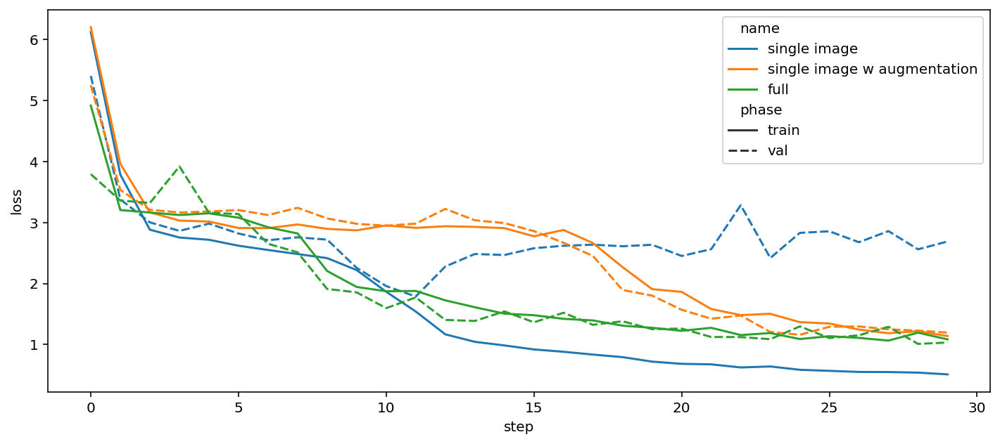

In [31]:
sns.lineplot(data=df, x='step', y='loss', hue = 'name', style='phase')

In [32]:
%%capture
Y_trn_pred = [model_full.predict_instances(x, n_tiles=model_full._guess_n_tiles(x), show_tile_progress=False)[0]
              for x in tqdm([img])]

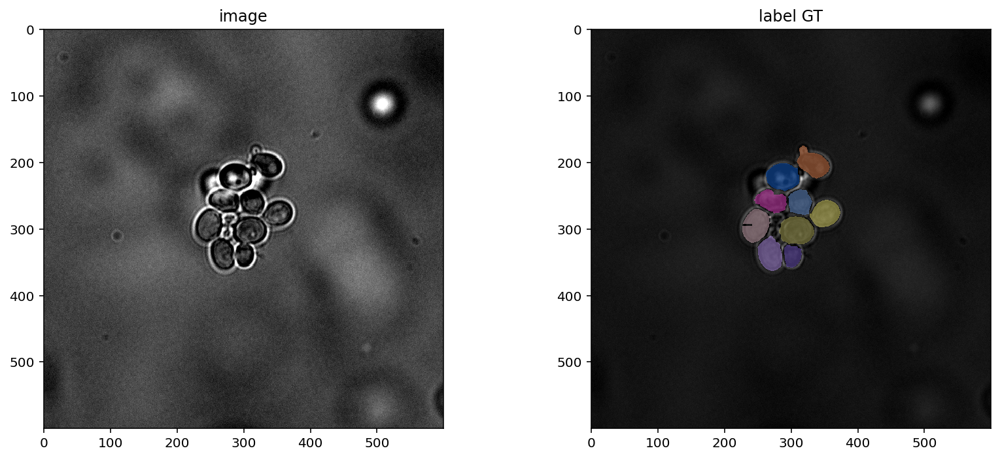

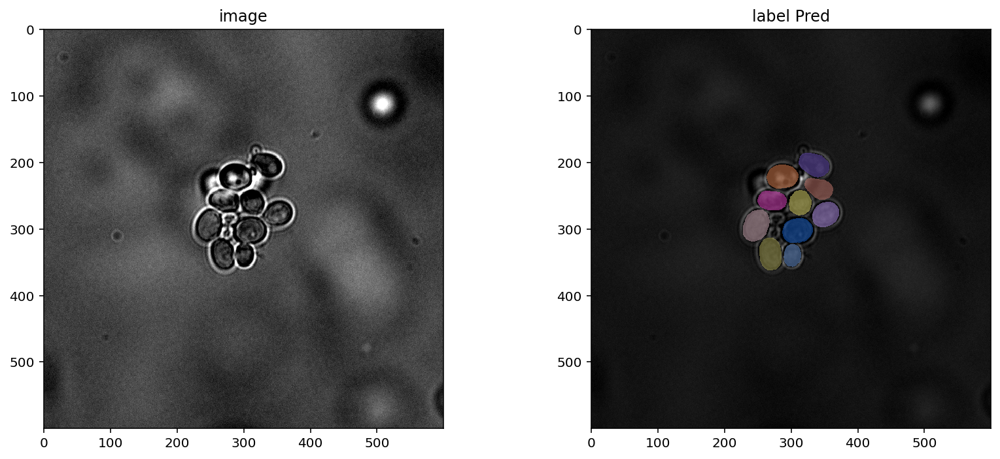

In [33]:
plot_img_label(img, lbl, lbl_title="label GT")
plot_img_label(img,Y_trn_pred[0], lbl_title="label Pred")

In [34]:
%%capture
Y_val_pred = [model_full.predict_instances(x, n_tiles=model_full._guess_n_tiles(x), show_tile_progress=False)[0]
              for x in tqdm(X_val)]

### Prediction on unseen test image (Full model)

1/1 [==============================] - 0s 22ms/step


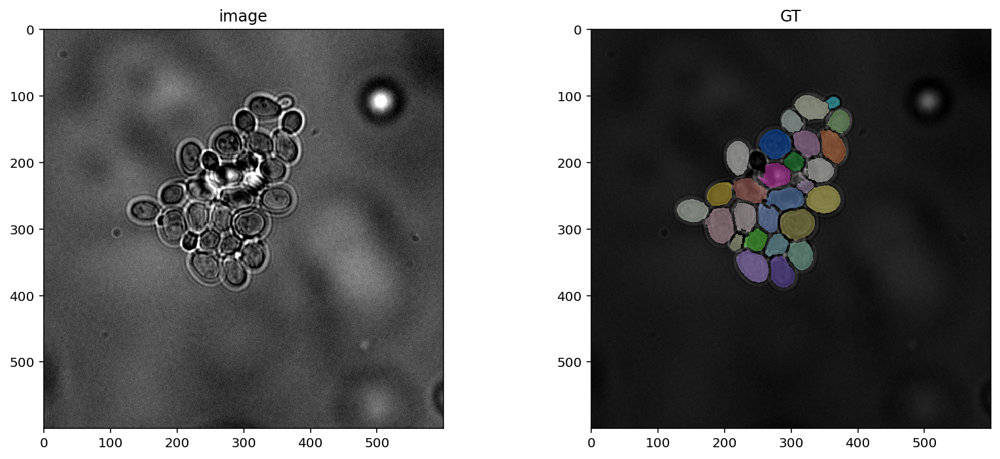

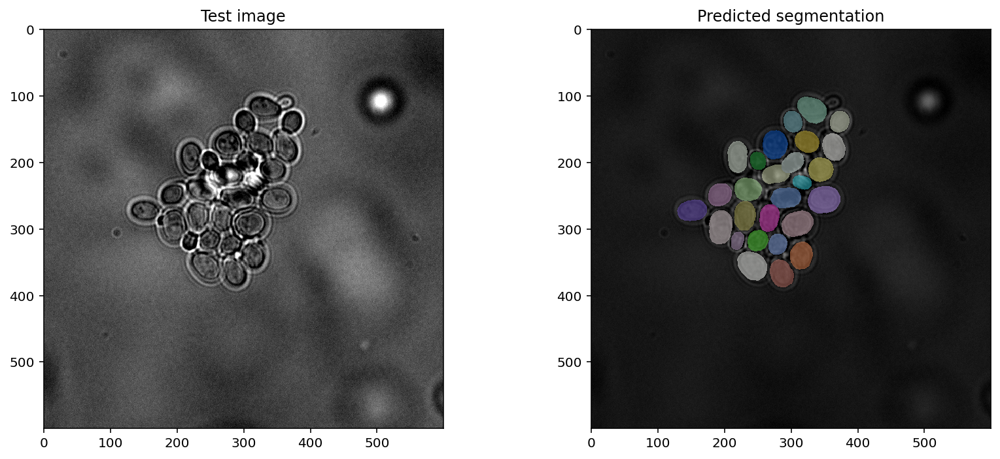

In [35]:
Y_pred_full, _  = model_full.predict_instances(X_test[idx_test])

plot_img_label(X_test[idx_test],Y_test[idx_test], lbl_title="GT")
plot_img_label(X_test[idx_test], Y_pred_full, img_title=f"Test image", lbl_title="Predicted segmentation")

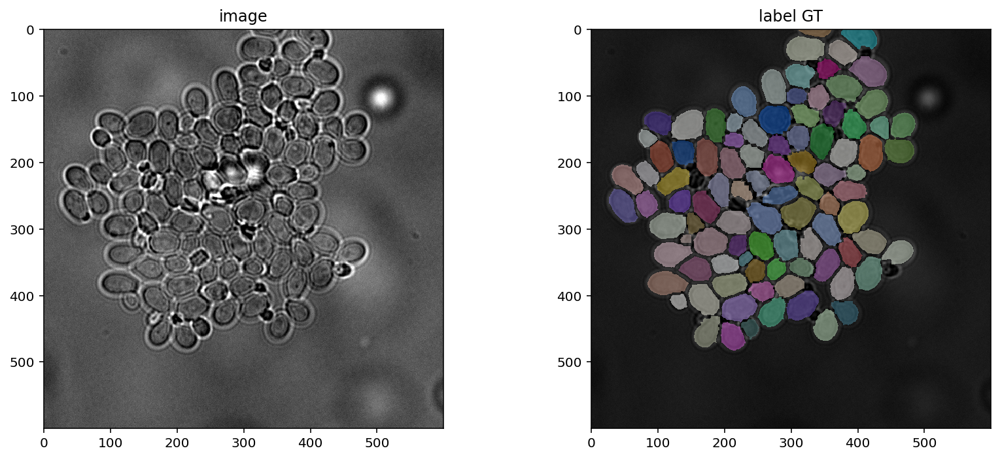

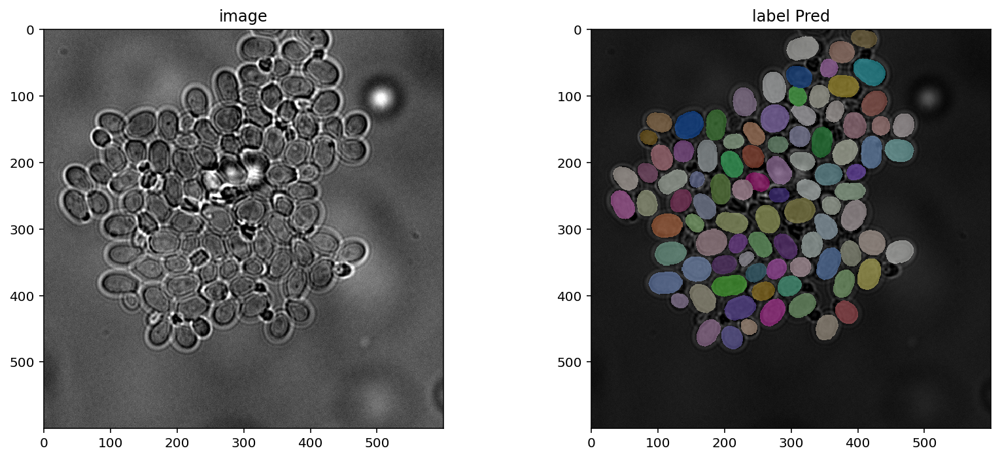

In [38]:
idx = 3
plot_img_label(X_val[idx],Y_val[idx], lbl_title="label GT")
plot_img_label(X_val[idx],Y_val_pred[idx], lbl_title="label Pred")